In [1]:
import os
import matplotlib.pyplot as plt
import cv2
import pandas as pd
import random
import copy
import shutil
import numpy as np
import ipywidgets as widgets
import wandb

In [2]:
from ultralytics import YOLO

In [3]:
import os
dataset_folder = 'Input'
train_val_folder = 'train_val'
test_folder = 'TEST'
images_folder = 'images'
masks_folder = 'masks'
ip_folder = ''
train_images_path = os.path.join(ip_folder, dataset_folder, train_val_folder, images_folder)
test_images_path = os.path.join(ip_folder, dataset_folder, test_folder, images_folder)
train_masks_path = os.path.join(ip_folder, dataset_folder, train_val_folder, masks_folder)
test_masks_path = os.path.join(ip_folder, dataset_folder, test_folder, masks_folder)


In [4]:
op_folder_name = 'Output'
op_path = os.getcwd()
op_labels_path = os.path.join(op_path, op_folder_name, 'labels')
op_images_path = os.path.join(op_path, op_folder_name, 'images')
op_images_trainpath = os.path.join(op_images_path, 'train')
op_images_valpath = os.path.join(op_images_path, 'val')
op_images_testpath = os.path.join(op_images_path, 'test')
op_labels_trainpath = os.path.join(op_labels_path, 'train')
op_labels_valpath = os.path.join(op_labels_path, 'val')
op_labels_testpath = os.path.join(op_labels_path, 'test')
os.makedirs(op_images_trainpath, exist_ok=True)
os.makedirs(op_images_valpath, exist_ok=True)
os.makedirs(op_images_testpath, exist_ok=True)
os.makedirs(op_labels_trainpath, exist_ok=True)
os.makedirs(op_labels_valpath, exist_ok=True)
os.makedirs(op_labels_testpath, exist_ok=True)


In [5]:
train_imgs_list=sorted(os.listdir(train_images_path))
train_masks_list=sorted(os.listdir(train_masks_path))
test_imgs_list=sorted(os.listdir(test_images_path))
test_masks_list=sorted(os.listdir(test_masks_path))

In [6]:
test_masks_list=list(filter (lambda x: x.endswith('bmp'), test_masks_list))

In [7]:
total_images_train=len(train_imgs_list)
total_images_train

1525

In [8]:
total_images_test=len(test_imgs_list)
total_images_test

110

In [9]:
def plot_image_and_mask():
    figure,axis = plt.subplots(1,2,figsize=(30,30))
    plt.axis('off')
    k=random.randint(0, total_images_train-1) 
    
    img_path=os.path.join(train_images_path, train_imgs_list[k]) 
    mask_path=os.path.join(train_masks_path, train_masks_list[k])
    
    img_title=os.path.basename(img_path) 
    mask_title=os.path.basename(mask_path) 
    
    axis[0].imshow(cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB))
    axis[0].set_title(img_title, fontsize=30)
    axis[0].set_xticks([])
    axis[0].set_yticks([])
    axis[1].imshow(cv2.cvtColor(cv2.imread(mask_path), cv2.COLOR_BGR2RGB))
    axis[1].set_title(mask_title, fontsize=30)
    axis[1].set_xticks([])
    axis[1].set_yticks([])

    plt.tight_layout()
    plt.show()

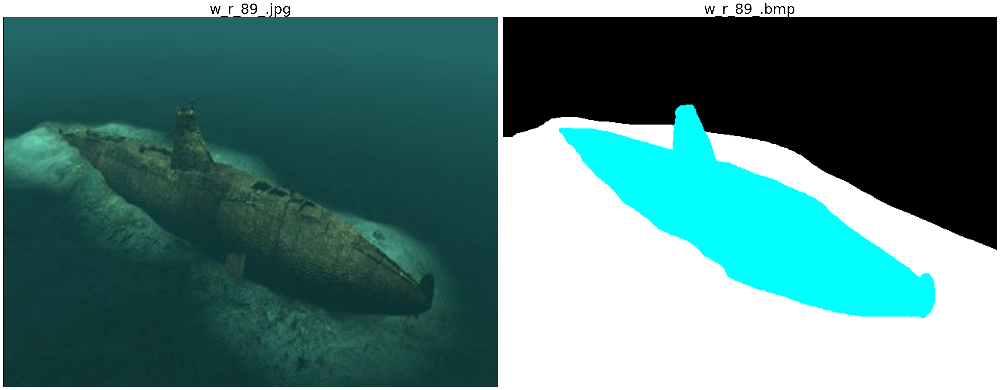

In [10]:
plot_image_and_mask()

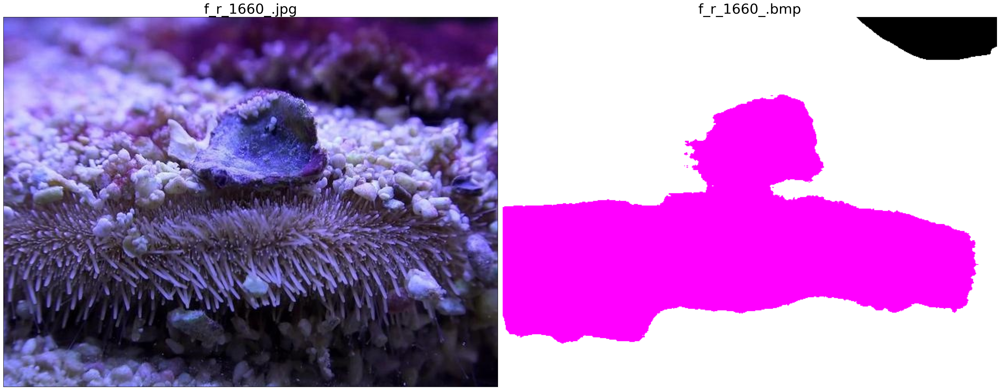

In [11]:
plot_image_and_mask()

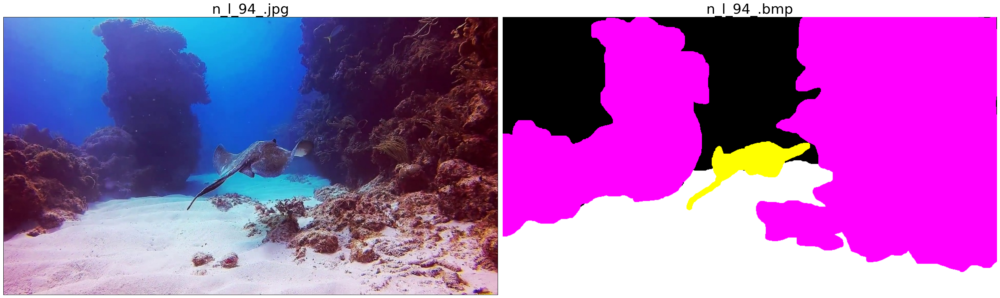

In [12]:
plot_image_and_mask()

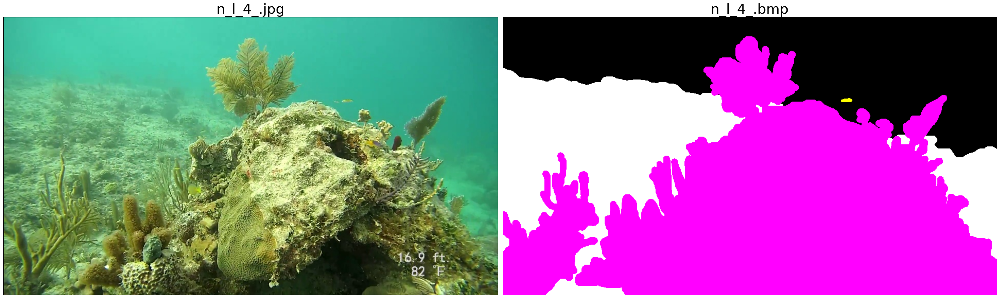

In [13]:
plot_image_and_mask()

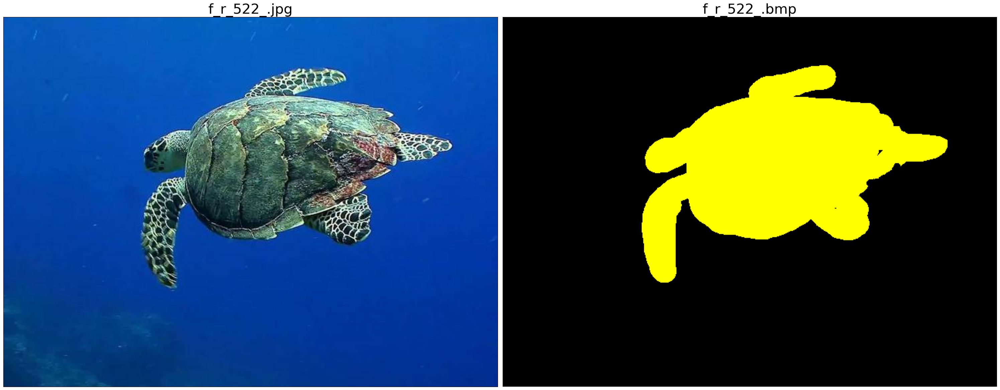

In [14]:
plot_image_and_mask()

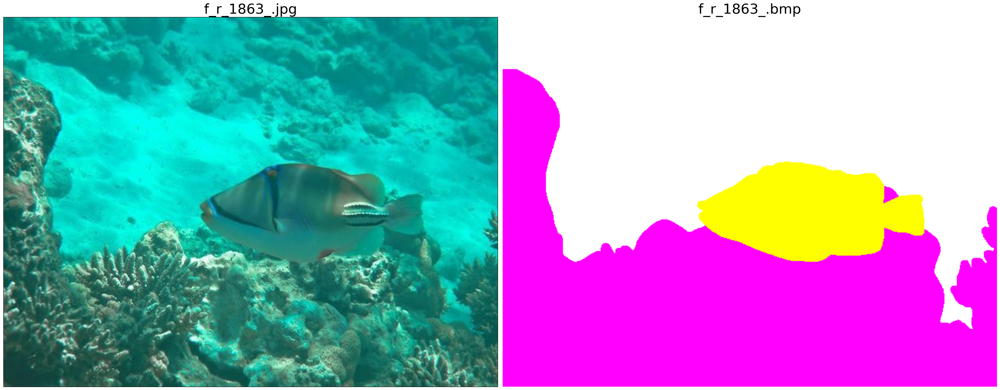

In [15]:
plot_image_and_mask()

In [11]:
color_class_mapping={(0, 0, 0): 0,
                    (0, 0, 255): 1,
                    (0, 255, 0): 2,
                    (0, 255, 255): 3,
                    (255, 0, 0): 4,
                    (255, 0, 255): 5,
                    (255, 255, 0): 6,
                    (255, 255, 255): 7}

color_name_mapping={(0, 0, 0): 'black',
                    (0, 0, 255): 'blue',
                    (0, 255, 0): 'green',
                    (0, 255, 255): 'sky',
                    (255, 0, 0): 'red',
                    (255, 0, 255): 'pink',
                    (255, 255, 0): 'yellow',
                    (255, 255, 255): 'white'}

In [12]:
orange=(255,85,0)

In [13]:
def draw_contour_for_one_color_on_mask():
    figure,axis = plt.subplots(1,3,figsize=(30,30))
    plt.axis('off')
    k=random.randint(0, total_images_train-1) 
    
    img_path=os.path.join(train_images_path, train_imgs_list[k]) 
    img_title=os.path.basename(img_path) 
    img=cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
    
    mask_path=os.path.join(train_masks_path, train_masks_list[k]) 
    mask_title=os.path.basename(mask_path)
    mask=cv2.cvtColor(cv2.imread(mask_path), cv2.COLOR_BGR2RGB)
    
    mask_copy=copy.deepcopy(mask) 
    pixels = mask.reshape((-1, 3))
    unique_colors = np.unique(pixels, axis=0)
    
    unique_colors_defined = [value for value in unique_colors if tuple(value) in color_class_mapping]
    unique_colors_defined = np.array(unique_colors_defined, dtype=np.uint8)
    total_colors=len(unique_colors_defined)
    j=random.randint(0, total_colors-1)
    color=unique_colors_defined[j]
    mask_copy_title=os.path.basename(mask_path)+' with contour on color ' +str(color_name_mapping[tuple(color)])
    
    mask_mask = cv2.inRange(mask, color, color)
    contours, hrc = cv2.findContours(mask_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    cv2.drawContours(mask_copy, contours, -1, orange, 4) 
    
    axis[0].imshow(img)
    axis[0].set_title(img_title, fontsize=30)
    axis[0].set_xticks([])
    axis[0].set_yticks([])
    axis[1].imshow(mask)
    axis[1].set_title(mask_title, fontsize=30)
    axis[1].set_xticks([])
    axis[1].set_yticks([])
    axis[2].imshow(mask_copy) 
    axis[2].set_title(mask_copy_title, fontsize=30)
    axis[2].set_xticks([])
    axis[2].set_yticks([])

    plt.tight_layout()
    plt.show()

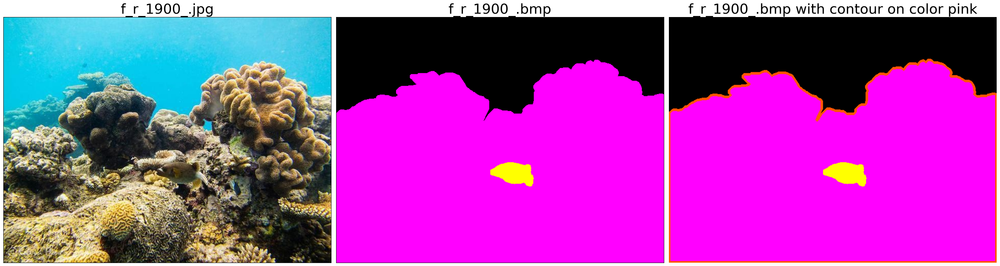

In [14]:
draw_contour_for_one_color_on_mask()

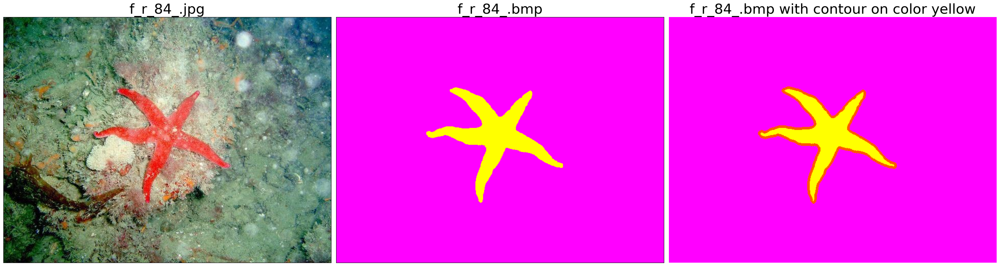

In [20]:
draw_contour_for_one_color_on_mask()

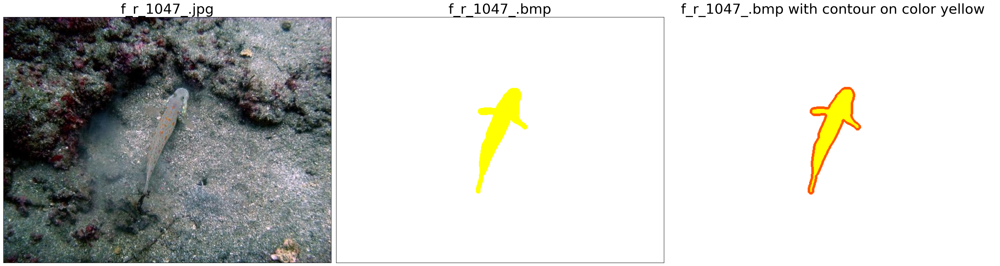

In [21]:
draw_contour_for_one_color_on_mask()

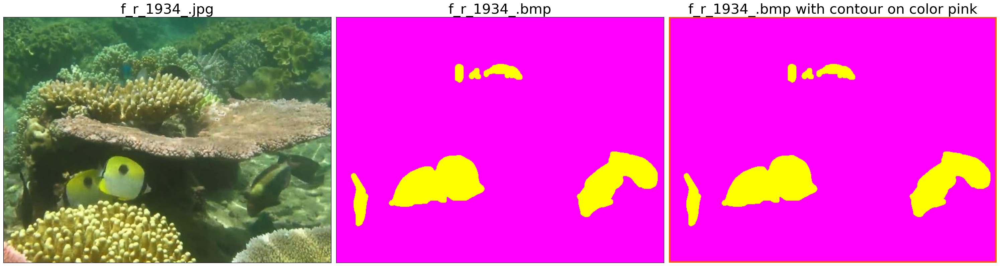

In [22]:
draw_contour_for_one_color_on_mask()

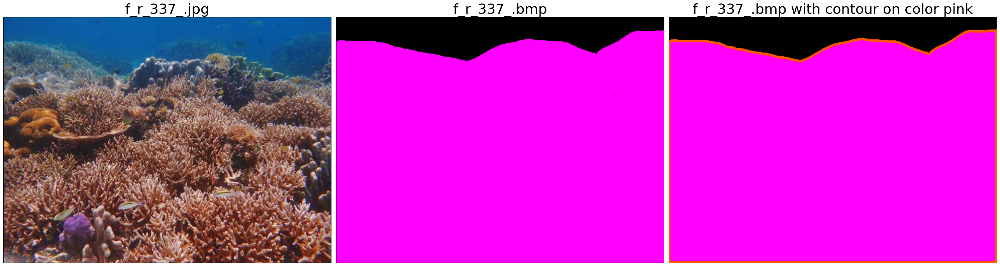

In [23]:
draw_contour_for_one_color_on_mask()

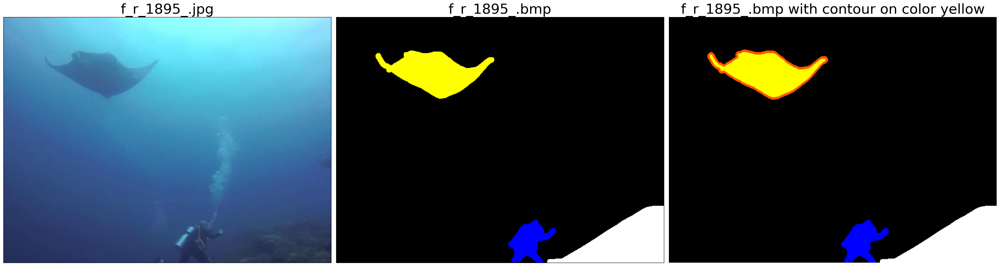

In [24]:
draw_contour_for_one_color_on_mask()

In [15]:
def write_polygon_file(class_contour_mapping, H, W, output_path, img_name):
    coordinates={}
    for obj in class_contour_mapping: 
        polygons = []
        for cnt in class_contour_mapping[obj]: 
            if cv2.contourArea(cnt) > 20: 
                polygon = []
                for point in cnt: 
                    x, y = point[0]
                    polygon.append(round(x / W, 4))
                    polygon.append(round(y / H, 4))
                polygons.append(polygon)
        coordinates[obj]=polygons

    with open('{}.txt'.format(os.path.join(output_path, img_name)), 'w') as f:
        for obj in coordinates:
            for polygon in coordinates[obj]:
                for p_, p in enumerate(polygon):
                    if p_ == len(polygon) - 1:  
                        f.write('{}\n'.format(p))
                    elif p_ == 0: 
                        f.write('{} {} '.format(obj, p))
                    else: 
                        f.write('{} '.format(p))

In [16]:
progress_bar=widgets.FloatProgress(value=0, min=0, max=100, description='Progress', 
                                   layout=widgets.Layout(width='100%'))
progress_bar

FloatProgress(value=0.0, description='Progress', layout=Layout(width='100%'))

In [17]:
m=0

for img in train_masks_list:
    
    image=cv2.cvtColor(cv2.imread(os.path.join(train_masks_path,img)), cv2.COLOR_BGR2RGB)
    
    pixels = image.reshape((-1, 3))
    unique_colors = np.unique(pixels, axis=0) 
    
  
    unique_colors_defined = [value for value in unique_colors if tuple(value) in color_class_mapping]
    unique_colors_defined = np.array(unique_colors_defined, dtype=np.uint8)
    total_colors=len(unique_colors_defined)
        
    img_name=os.path.splitext(img)[0] 
    img_full_name=img_name+'.jpg' 

    img_path=os.path.join(train_images_path, img_full_name) 
    shutil.copy(img_path, op_images_trainpath)

    H,W,_=image.shape
    class_contour_mapping={}

    for i in range(total_colors): 
        color=unique_colors_defined[i] 
        class_code=color_class_mapping[tuple(color)]
        mask = cv2.inRange(image, color, color)
        contours, hrc = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
        class_contour_mapping[class_code]=contours 
    write_polygon_file(class_contour_mapping, H, W, op_labels_trainpath, img_name)
    m=m+1
    progress_bar.value=m/len(train_masks_list)*100    
    
print("Total number of labels created: ", m)    

Total number of labels created:  1525


In [18]:
progress_bar.value=0
progress_bar

FloatProgress(value=0.0, description='Progress', layout=Layout(width='100%'))

In [19]:
m=0
for img in test_masks_list:
    
    image=cv2.cvtColor(cv2.imread(os.path.join(test_masks_path,img)), cv2.COLOR_BGR2RGB)
    
    pixels = image.reshape((-1, 3))
    unique_colors = np.unique(pixels, axis=0)
    unique_colors_defined = [value for value in unique_colors if tuple(value) in color_class_mapping]
    unique_colors_defined = np.array(unique_colors_defined, dtype=np.uint8)
    total_colors=len(unique_colors_defined)
    img_name=os.path.splitext(img)[0]
    img_full_name=img_name+'.jpg'

    img_path=os.path.join(test_images_path, img_full_name)
    shutil.copy(img_path, op_images_testpath)

    H,W,_=image.shape
    class_contour_mapping={}
    for i in range(total_colors):
        color=unique_colors_defined[i]
        class_code=color_class_mapping[tuple(color)]
        mask = cv2.inRange(image, color, color)
        contours, hrc = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
        class_contour_mapping[class_code]=contours

    write_polygon_file(class_contour_mapping, H, W, op_labels_testpath, img_name)
    m=m+1
    progress_bar.value=m/len(test_masks_list)*100

    
print("Total number of labels created: ", m)   

Total number of labels created:  110


In [20]:
def create_validation_data(dataset, size):
    random.shuffle(dataset)
    validation_data=dataset[:size]
    return validation_data
    

In [21]:
validation_datalist=create_validation_data(train_imgs_list, 110)

In [22]:
for img in validation_datalist:
    imgsrc_path=os.path.join(op_images_trainpath, img)
    imgdst_path=os.path.join(op_images_valpath, img)
    shutil.move(imgsrc_path, imgdst_path)
    
    img_name=os.path.splitext(img)[0]
    label_file=img_name+'.txt'
    
    labelsrc_path=os.path.join(op_labels_trainpath,label_file)
    labeldst_path=os.path.join(op_labels_valpath,label_file)
    shutil.move(labelsrc_path, labeldst_path)

In [23]:
newline='\n'

In [34]:
ln_1='# Train/val/test sets'+newline 

ln_2='train: ' +"'"+op_images_trainpath+"'"+newline
ln_3='val: ' +"'" + op_images_valpath+"'"+newline
ln_4='test: ' +"'" + op_images_testpath+"'"+newline
ln_5=newline

ln_6='names:'+newline
ln_7='  0: background'+newline
ln_8='  1: Human divers'+newline
ln_9='  2: Aquatic plants and sea-grass'+newline
ln_10='  3: Wrecks and ruins'+newline
ln_11='  4: Robots'+newline
ln_12='  5: Reefs and invertebrates'+newline
ln_13='  6: Fish and vertebrates'+newline
ln_14='  7: Sea-floor and rocks'
config_lines=[ln_1, ln_2, ln_3, ln_4, ln_5, ln_6, ln_7, ln_8, ln_9, ln_10, ln_11, ln_12, ln_13, ln_14]

In [35]:
config_path=os.path.join(op_path, 'config.yaml')
config_path

'C:\\Users\\Gayathri Murugesan\\phase 1\\config.yaml'

In [36]:
with open(config_path, 'w') as f:
    f.writelines(config_lines)

In [37]:
import tensorflow as tf
with tf.device('/GPU:0'):    
    model=YOLO('yolov8m-seg.yaml').load('yolov8m-seg.pt')


                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics.nn.modules.conv.Conv             [384

In [40]:
with tf.device('/GPU:0'):
    results=model.train(data=config_path, epochs=2, degrees=60, shear=30, perspective=0.0005, boxes=False)

New https://pypi.org/project/ultralytics/8.0.227 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.215 🚀 Python-3.11.5 torch-2.1.1+cpu CPU (AMD Ryzen 5 5500U with Radeon Graphics)
engine\trainer: task=segment, mode=train, model=yolov8m-seg.yaml, data=C:\Users\Gayathri Murugesan\phase 1\config.yaml, epochs=2, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train20, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_wi

wandb: Currently logged in as: gayathrimurugesan9 (underwater_img). Use `wandb login --relogin` to force relogin


Freezing layer 'model.22.dfl.conv.weight'


train: Scanning C:\Users\Gayathri Murugesan\phase 1\Output\labels\train... 1415 images, 0 backgrounds, 0 corrupt: 100%|


train: New cache created: C:\Users\Gayathri Murugesan\phase 1\Output\labels\train.cache


val: Scanning C:\Users\Gayathri Murugesan\phase 1\Output\labels\val... 1010 images, 0 backgrounds, 0 corrupt: 100%|████


val: New cache created: C:\Users\Gayathri Murugesan\phase 1\Output\labels\val.cache
Plotting labels to runs\segment\train20\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000833, momentum=0.9) with parameter groups 86 weight(decay=0.0), 97 weight(decay=0.0005), 96 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs\segment\train20
Starting training for 2 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


        1/2         0G       1.35      2.995        2.2      1.536        134        640: 100%|██████████| 89/89 [2:53:
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP


                   all       1010      12053      0.379       0.33      0.279      0.169      0.367      0.306      0.264      0.137

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


        2/2         0G      1.277       2.62      1.714      1.454        116        640: 100%|██████████| 89/89 [2:42:
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP


                   all       1010      12053      0.471      0.348      0.327      0.212      0.456      0.333      0.311      0.171

2 epochs completed in 6.107 hours.
Optimizer stripped from runs\segment\train20\weights\last.pt, 54.8MB
Optimizer stripped from runs\segment\train20\weights\best.pt, 54.8MB

Validating runs\segment\train20\weights\best.pt...
Ultralytics YOLOv8.0.215 🚀 Python-3.11.5 torch-2.1.1+cpu CPU (AMD Ryzen 5 5500U with Radeon Graphics)
YOLOv8m-seg summary (fused): 245 layers, 27227016 parameters, 0 gradients, 110.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP


                   all       1010      12053      0.471      0.348      0.327      0.212      0.456      0.333      0.311      0.171
            background       1010       2999      0.528      0.288      0.288      0.177      0.531       0.29      0.279      0.152
          Human divers       1010        368       0.65      0.717      0.693      0.498      0.652       0.72      0.702      0.432
Aquatic plants and sea-grass       1010        479      0.253    0.00214     0.0213     0.0114      0.253    0.00214     0.0191    0.00772
      Wrecks and ruins       1010        284      0.295      0.423       0.25      0.144      0.246      0.352      0.195     0.0958
                Robots       1010         64      0.808      0.132      0.323      0.256      0.808      0.132      0.326      0.223
Reefs and invertebrates       1010       1352      0.583      0.316      0.358      0.251      0.523      0.283      0.304       0.15
  Fish and vertebrates       1010       5287      0.404      0

lr/pg0,▁█
lr/pg1,▁█
lr/pg2,▁█
metrics/mAP50(B),▁█
metrics/mAP50(M),▁█
metrics/mAP50-95(B),▁█
metrics/mAP50-95(M),▁█
metrics/precision(B),▁█
metrics/precision(M),▁█
metrics/recall(B),▁█
metrics/recall(M),▁█


In [38]:
wandb.login(key="fed4f9c8bdc1f9a389a69faf4e2ca00b6f7d70ce")

wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: C:\Users\Gayathri Murugesan/.netrc


True

In [39]:
def evaluate_map50(trainedmodel, data_path, dataset='val'):
    metrics=trainedmodel.val(data=data_path, split=dataset)
    map50=round(metrics.seg.map50, 3)
    print("The mAP of model for all images on {0} dataset is {1}".format(dataset,map50))
    return metrics, map50

In [40]:

def display_curves(root_path):
    plt.figure(figsize=(50,50))
    
    p_curve=cv2.imread(os.path.join(root_path,'MaskP_curve.png'))
    ax=plt.subplot(5,1,1)
    plt.imshow(p_curve)
    
    r_curve=cv2.imread(os.path.join(root_path,'MaskR_curve.png'))
    ax=plt.subplot(5,1,2)
    plt.imshow(r_curve)
    
    pr_curve=cv2.imread(os.path.join(root_path,'MaskPR_curve.png'))
    ax=plt.subplot(5,1,3)
    plt.imshow(pr_curve)
    
    f1_curve=cv2.imread(os.path.join(root_path,'MaskF1_curve.png'))
    ax=plt.subplot(5,1,4)
    plt.imshow(f1_curve)
    
    confusion_matrix=cv2.imread(os.path.join(root_path,'confusion_matrix.png'))
    ax=plt.subplot(5,1,5)
    plt.imshow(confusion_matrix)

In [41]:
test_metrics, test_map50=evaluate_map50(model, config_path, dataset='test')

Ultralytics YOLOv8.0.215 🚀 Python-3.11.5 torch-2.1.1+cpu CPU (AMD Ryzen 5 5500U with Radeon Graphics)
YOLOv8m-seg summary (fused): 245 layers, 27268704 parameters, 211152 gradients, 110.2 GFLOPs


val: Scanning C:\Users\Gayathri Murugesan\phase 1\Output\labels\test.cache... 110 images, 0 backgrounds, 0 corrupt: 100
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP


                   all        110       1201     0.0452      0.089     0.0417     0.0302     0.0354     0.0866      0.033     0.0233
                     0        110        309    0.00877     0.0291     0.0047    0.00164   0.000975    0.00324   0.000492   0.000295
                     1        110         58      0.205      0.138      0.156      0.103      0.128     0.0862     0.0866     0.0585
                     2        110         70          0          0          0          0          0          0          0          0
                     3        110         39     0.0617      0.128     0.0353     0.0331     0.0617      0.128     0.0353     0.0258
                     4        110         17     0.0449      0.412      0.117     0.0855     0.0513      0.471      0.121     0.0837
                     5        110        159          0          0          0          0          0          0          0          0
                     6        110        414     0.0408    0.00483   

In [44]:
test_path=os.path.join(op_path, 'runs', 'segment', 'train202') #val is a misnomer, it is actually measuring validation on test dataset3

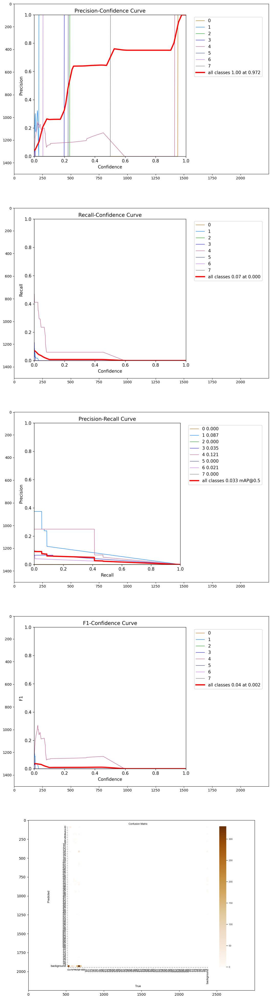

In [45]:
display_curves(test_path) 

In [ ]:
import os
import random
import cv2
import matplotlib.pyplot as plt



plt.figure(figsize=(30,30))

for i in range(1, 6, 2):
    m = random.randint(0, len(test_imgs_list))  # Selecting random image number from the test dataset
    test_image = os.path.join(op_images_testpath, os.listdir(test_images_path)[m])
    
    ax = plt.subplot(3, 2, i)
    plt.imshow(cv2.cvtColor(cv2.imread(test_image), cv2.COLOR_BGR2RGB))
    plt.xticks([])
    plt.yticks([])
    plt.title("Actual image", fontsize=40)

    res = model(test_image)
    res_plotted = res[0].plot()
    ax = plt.subplot(3, 2, i + 1)
    plt.imshow(res_plotted)
    plt.title("Image with predictions", fontsize=40)
    plt.xticks([])
    plt.yticks([])
55
    output_filename = f"predicted_image_{i // 2}.png"
   # output_filepath = os.path.join(output_path, output_filename)
   # plt.savefig(output_filepath)

# Show the plotted images
plt.show()
